In [1]:
pip install pandas matplotlib seaborn


Note: you may need to restart the kernel to use updated packages.


# LOADING THE DATASET

import pandas as pd

# Load the dataset
df = pd.read_csv("globalterrorismdb_0718dist.csv", encoding='latin1')
df.head()


# UNDERSTAND THE DATA

In [7]:
# Overview of dataset
print("Shape of dataset:", df.shape)
print("Columns:", df.columns.tolist())

# Basic info
df.info()

# Check for missing values
df.isnull().sum().sort_values(ascending=False).head(10)


Shape of dataset: (181691, 135)
Columns: ['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended', 'resolution', 'country', 'country_txt', 'region', 'region_txt', 'provstate', 'city', 'latitude', 'longitude', 'specificity', 'vicinity', 'location', 'summary', 'crit1', 'crit2', 'crit3', 'doubtterr', 'alternative', 'alternative_txt', 'multiple', 'success', 'suicide', 'attacktype1', 'attacktype1_txt', 'attacktype2', 'attacktype2_txt', 'attacktype3', 'attacktype3_txt', 'targtype1', 'targtype1_txt', 'targsubtype1', 'targsubtype1_txt', 'corp1', 'target1', 'natlty1', 'natlty1_txt', 'targtype2', 'targtype2_txt', 'targsubtype2', 'targsubtype2_txt', 'corp2', 'target2', 'natlty2', 'natlty2_txt', 'targtype3', 'targtype3_txt', 'targsubtype3', 'targsubtype3_txt', 'corp3', 'target3', 'natlty3', 'natlty3_txt', 'gname', 'gsubname', 'gname2', 'gsubname2', 'gname3', 'gsubname3', 'motive', 'guncertain1', 'guncertain2', 'guncertain3', 'individual', 'nperps', 'nperpcap', 'claimed', 'claimmode', 'claim

gsubname3           181671
weapsubtype4_txt    181621
weapsubtype4        181621
weaptype4           181618
weaptype4_txt       181618
claimmode3          181558
claimmode3_txt      181558
gsubname2           181531
claim3              181373
guncertain3         181371
dtype: int64

# SELECT RELEVANT COLUMN FOR ANALYSIS

In [10]:
df = df[['iyear', 'imonth', 'iday', 'country_txt', 'region_txt', 'provstate', 'city', 
         'latitude', 'longitude', 'attacktype1_txt', 'targtype1_txt', 'weaptype1_txt', 
         'nkill', 'nwound', 'summary']]

df.rename(columns={
    'iyear':'Year',
    'imonth':'Month',
    'iday':'Day',
    'country_txt':'Country',
    'region_txt':'Region',
    'provstate':'State',
    'city':'City',
    'attacktype1_txt':'Attack Type',
    'targtype1_txt':'Target Type',
    'weaptype1_txt':'Weapon Type',
    'nkill':'Killed',
    'nwound':'Wounded'
}, inplace=True)


# HOT ZONE ANALYSIS

# 1.Top Countries with Highest Terror Attacks

<Axes: title={'center': 'Top 10 Countries with Terror Attacks'}, xlabel='Country'>

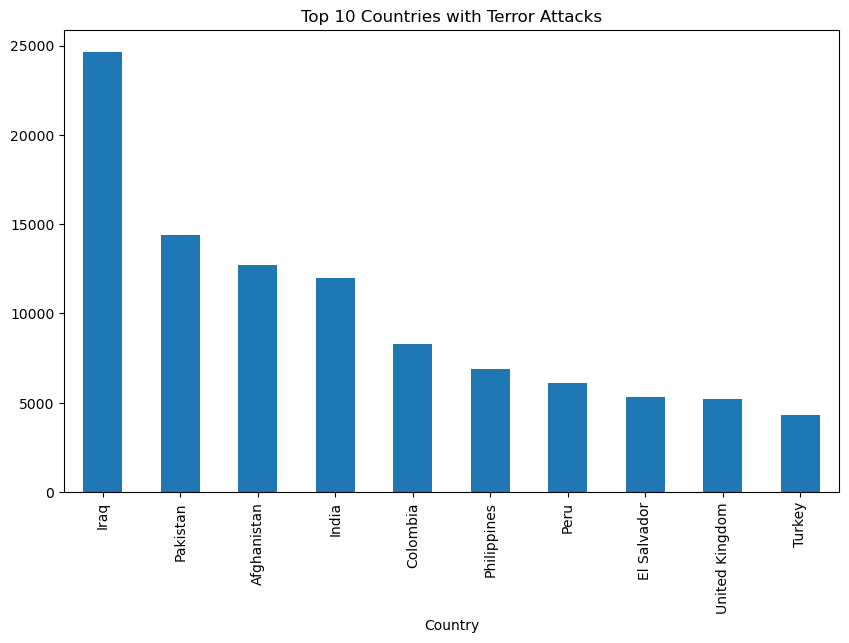

In [14]:
top_countries = df['Country'].value_counts().head(10)
top_countries.plot(kind='bar', title='Top 10 Countries with Terror Attacks', figsize=(10,6))


# 2. Region-wise Terror Attacks

<Axes: title={'center': 'Terror Attacks by Region'}, ylabel='Region'>

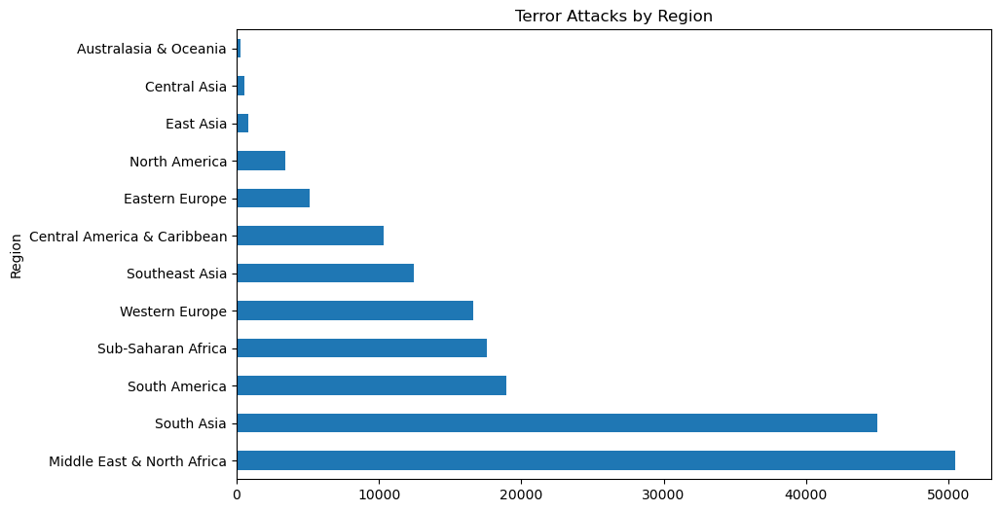

In [18]:
df['Region'].value_counts().plot(kind='barh', figsize=(10,6), title='Terror Attacks by Region')


# 3. Yearly Trend of Attacks

<Axes: title={'center': 'Terror Attacks Over the Years'}, xlabel='Year'>

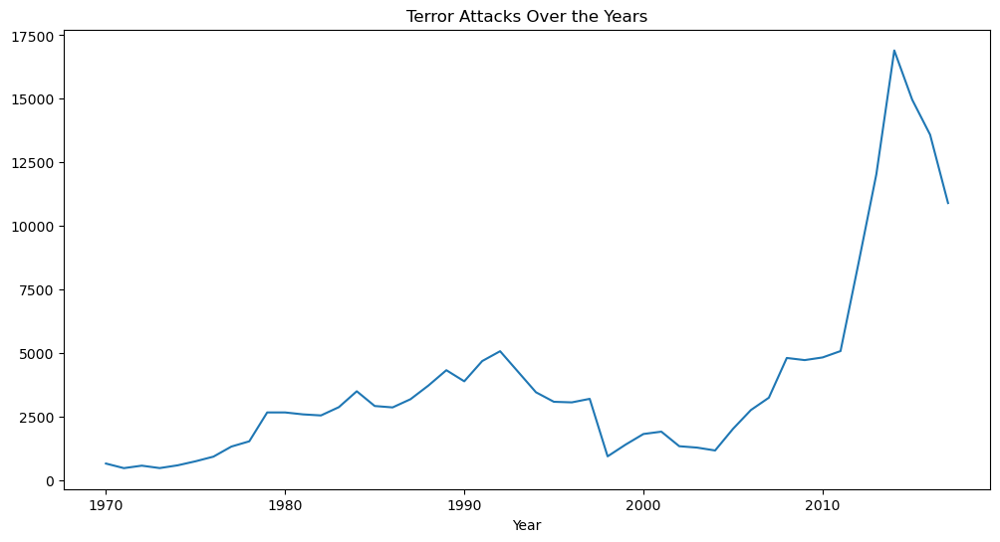

In [23]:
df['Year'].value_counts().sort_index().plot(kind='line', figsize=(12,6), title='Terror Attacks Over the Years')


# 4. Most Common Attack Types

<Axes: title={'center': 'Most Common Attack Types'}, xlabel='Attack Type'>

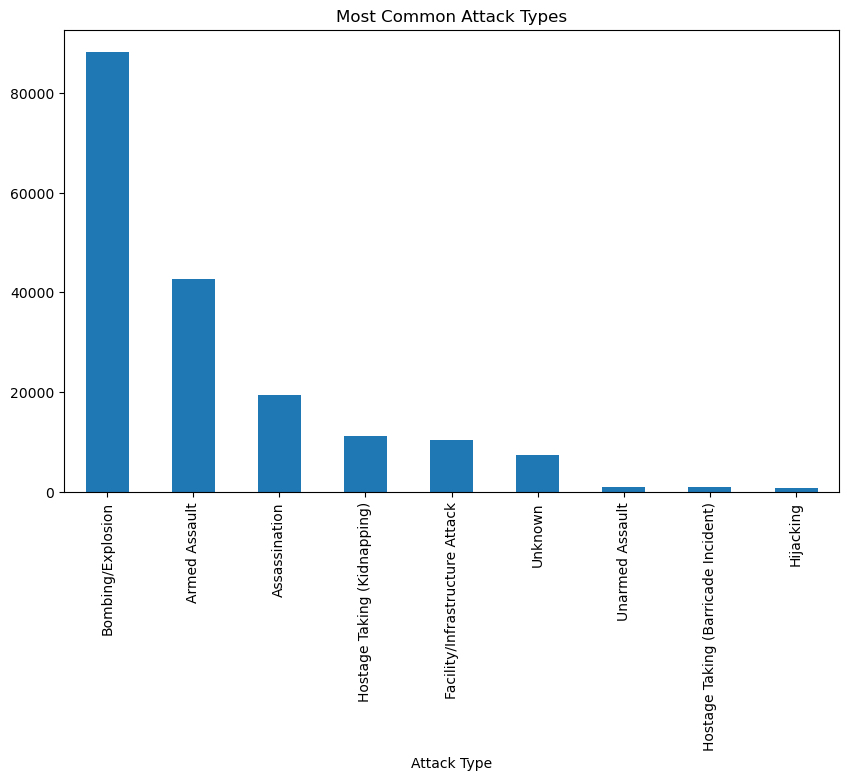

In [25]:
df['Attack Type'].value_counts().plot(kind='bar', figsize=(10,6), title='Most Common Attack Types')


# 5. City-Level Hotspots (excluding "Unknown")

<Axes: title={'center': 'Top 10 Cities with Terror Incidents'}, xlabel='City'>

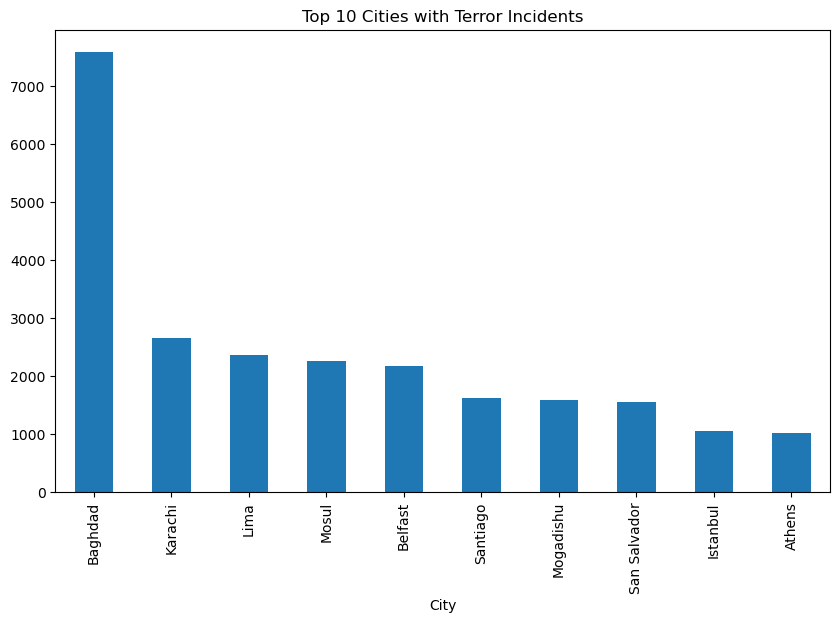

In [27]:
hot_cities = df[df['City'] != 'Unknown']['City'].value_counts().head(10)
hot_cities.plot(kind='bar', title='Top 10 Cities with Terror Incidents', figsize=(10,6))


# MAP VISIZUALIZATION

In [30]:
pip install plotly


Note: you may need to restart the kernel to use updated packages.


In [32]:
import plotly.express as px

map_data = df[['Country', 'Region', 'City', 'latitude', 'longitude', 'Killed']]
map_data.dropna(inplace=True)

fig = px.scatter_geo(map_data,
                     lat='latitude',
                     lon='longitude',
                     color='Region',
                     size='Killed',
                     hover_name='City',
                     projection='natural earth',
                     title='Global Terrorism Hotspots')
fig.show()


C:\Users\HP\AppData\Local\Temp\ipykernel_10080\10992732.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  map_data.dropna(inplace=True)
